## Łukasz Kochańczyk, gr. 1

In [1]:
import pyspark
from pyspark.sql import SparkSession
from pyspark.sql.functions import *

spark = SparkSession.builder.appName("KcHouseData").master("local[*]").getOrCreate()

Setting default log level to "WARN".
To adjust logging level use sc.setLogLevel(newLevel). For SparkR, use setLogLevel(newLevel).
24/04/26 18:22:38 WARN NativeCodeLoader: Unable to load native-hadoop library for your platform... using builtin-java classes where applicable


### 1 Utworzenie sesji Spark i załadowanie danych

In [3]:
from pyspark import SparkFiles
 
url = "https://dysk.agh.edu.pl/s/nWNWeirnCJDQycp/download/kc_house_data.csv.gz"
spark.sparkContext.addFile(url)
 
df = spark.read.csv(SparkFiles.get("kc_house_data.csv.gz"), header=True, inferSchema=True)
df.show(5)

+----------+---------------+--------+--------+---------+-----------+--------+------+----------+----+---------+-----+----------+-------------+--------+------------+-------+-------+--------+-------------+----------+
|        id|           date|   price|bedrooms|bathrooms|sqft_living|sqft_lot|floors|waterfront|view|condition|grade|sqft_above|sqft_basement|yr_built|yr_renovated|zipcode|    lat|    long|sqft_living15|sqft_lot15|
+----------+---------------+--------+--------+---------+-----------+--------+------+----------+----+---------+-----+----------+-------------+--------+------------+-------+-------+--------+-------------+----------+
|7129300520|20141013T000000|221900.0|       3|      1.0|       1180|    5650|   1.0|         0|   0|        3|    7|      1180|            0|    1955|           0|  98178|47.5112|-122.257|         1340|      5650|
|6414100192|20141209T000000|538000.0|       3|     2.25|       2570|    7242|   2.0|         0|   0|        3|    7|      2170|          400|   

In [4]:
pdf = df.toPandas()
print(pdf.info())
pdf.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int32  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int32  
 6   sqft_lot       21613 non-null  int32  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int32  
 9   view           21613 non-null  int32  
 10  condition      21613 non-null  int32  
 11  grade          21613 non-null  int32  
 12  sqft_above     21613 non-null  int32  
 13  sqft_basement  21613 non-null  int32  
 14  yr_built       21613 non-null  int32  
 15  yr_renovated   21613 non-null  int32  
 16  zipcode        21613 non-null  int32  
 17  lat            21613 non-null  float64
 18  long  

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


### 2 Przetwarzanie wstępne

In [6]:
df = df.withColumn("date", to_timestamp("date", "yyyyMMdd'T'HHmmss"))
df = df.withColumn("unixdate", unix_timestamp("date")).drop("date")
df = df.drop("id")

### 3. Regresja

In [8]:
from pyspark.ml.regression import LinearRegression
from pyspark.ml.feature import VectorAssembler

In [9]:
input_columns = [col for col in df.columns if col != 'price']
va = VectorAssembler(inputCols=input_columns, outputCol="features")
df_va = va.transform(df)

In [10]:
lr = LinearRegression()\
  .setMaxIter(100)\
  .setRegParam(3.0)\
  .setElasticNetParam(0.5)\
  .setFeaturesCol("features")\
  .setLabelCol("price")

model = lr.fit(df_va)

24/04/26 18:23:01 WARN InstanceBuilder: Failed to load implementation from:dev.ludovic.netlib.blas.JNIBLAS
24/04/26 18:23:01 WARN InstanceBuilder: Failed to load implementation from:dev.ludovic.netlib.blas.VectorBLAS


In [11]:
print(f'RMSE: {model.summary.rootMeanSquaredError}')
print(f'r2: {model.summary.r2}')
print(f'iterations: {model.summary.totalIterations}')

RMSE: 200735.27852107986
r2: 0.7010253344728111
iterations: 37


#### 3.1 Train test split

In [13]:
from pyspark.ml.regression import LinearRegression
from pyspark.ml.feature import VectorAssembler
from pyspark.ml import Pipeline
from pyspark.ml.evaluation import RegressionEvaluator

In [14]:
df_train, df_test = df.randomSplit([0.7, 0.3], seed=1)

In [15]:
pipeline = Pipeline(stages=[va, lr])

In [16]:
model = pipeline.fit(df_train)
 
df_train_pred = model.transform(df_train)
df_test_pred = model.transform(df_test)

In [17]:
evaluator = RegressionEvaluator() \
                .setLabelCol("price") \
                .setPredictionCol("prediction") \
                .setMetricName("rmse");

rmse_train = evaluator.evaluate(df_train_pred);
rmse_test = evaluator.evaluate(df_test_pred)

evaluator = evaluator.setMetricName("r2")

r2_train = evaluator.evaluate(df_train_pred)
r2_test = evaluator.evaluate(df_test_pred)

In [18]:
print(f"RMSE on train data: {rmse_train}")
print(f"R2 on train data: {r2_train}")

RMSE on train data: 204884.06353335246
R2 on train data: 0.6979612248668865


In [19]:
print(f"RMSE on train data: {rmse_test}")
print(f"R2 on train data: {r2_test}")

RMSE on train data: 191057.3640296164
R2 on train data: 0.7077400039432729


In [20]:
total_count = df.count()
test_sizes = [1, 2, 3, 10, 20, 30, 100, 200, 300]

for k in test_sizes:
    test_size = k * len(df.columns) / total_count
    train_size = 1 - test_size
    df_train, df_test = df.randomSplit([train_size, test_size], seed=1)

    model = pipeline.fit(df_train)
    df_train_pred = model.transform(df_train)
    df_test_pred = model.transform(df_test)

    rmse_train = evaluator.evaluate(df_train_pred, {evaluator.metricName: "rmse"})
    r2_train = evaluator.evaluate(df_train_pred, {evaluator.metricName: "r2"})
    
    print(f"Test set size: {k}, RMSE on train data: {rmse_train}, R2 on train data: {r2_train}")

# Możemy zauważyć, że wyniki niewiele się różnią w zależności od liczebności zbioru

Test set size: 1, RMSE on train data: 200796.7715460887, R2 on train data: 0.701075262506604
Test set size: 2, RMSE on train data: 200865.2991262381, R2 on train data: 0.7010420045165038
Test set size: 3, RMSE on train data: 200912.7825232844, R2 on train data: 0.7008469690042483
Test set size: 10, RMSE on train data: 200987.8146115244, R2 on train data: 0.7006917128999505


Test set size: 20, RMSE on train data: 201287.79489828687, R2 on train data: 0.7008263487114443


Test set size: 30, RMSE on train data: 201418.85368434445, R2 on train data: 0.7010938684379351
Test set size: 100, RMSE on train data: 201116.94089756277, R2 on train data: 0.7017835998840594


Test set size: 200, RMSE on train data: 202495.67711607105, R2 on train data: 0.7000037285129825


Test set size: 300, RMSE on train data: 204181.09143784837, R2 on train data: 0.6977974085933258


#### 3.2 Funkcje

In [22]:
import pandas as pd
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

In [23]:
def evaluate_metrics(df, metrics=['r2','rmse','mse','mae'], label_col='price', prediction_col='prediction'):
    results = {}
    y_true = df[label_col]
    y_pred = df[prediction_col]
    
    for metric in metrics:
        if metric.lower() == 'r2':
            results['r2'] = r2_score(y_true, y_pred)
        elif metric.lower() == 'rmse':
            results['rmse'] = np.sqrt(mean_squared_error(y_true, y_pred))
        elif metric.lower() == 'mse':
            results['mse'] = mean_squared_error(y_true, y_pred)
        elif metric.lower() == 'mae':
            results['mae'] = mean_absolute_error(y_true, y_pred)
        else:
            raise ValueError(f"Unsupported metric: {metric}")
    
    return results

In [24]:
def train_and_test(df, lr=LinearRegression()
                          .setMaxIter(100)
                          .setRegParam(3.0)
                          .setElasticNetParam(0.5)
                          .setFeaturesCol("features")
                          .setLabelCol("price")):
    
    df_train, df_test = df.randomSplit([0.7, 0.3], seed=42)
    va = VectorAssembler(inputCols=[col for col in df.columns if col != 'price'], outputCol='features')
    pipeline = Pipeline(stages=[va, lr])

    model = pipeline.fit(df_train)
    return model

In [25]:
model = train_and_test(df)

In [26]:
df_columns = df.columns[1:]
coefficients = model.stages[1].coefficients

for column, coefficient in zip(df_columns, coefficients):
    print(f"{column}: {coefficient:.3f}")

bedrooms: -42931.133
bathrooms: 38359.602
sqft_living: 97.869
sqft_lot: 0.092
floors: 7471.382
waterfront: 561099.832
view: 55123.973
condition: 30190.961
grade: 93304.102
sqft_above: 96.406
sqft_basement: 62.186
yr_built: -2606.162
yr_renovated: 20.362
zipcode: -594.719
lat: 603816.275
long: -224664.682
sqft_living15: 25.102
sqft_lot15: -0.378
unixdate: 0.001


#### 3.3 Walidacja krzyżowa

In [28]:
from pyspark.ml.tuning import ParamGridBuilder, CrossValidator
 
cols = df.columns
cols.remove('price')
va=VectorAssembler().setInputCols(cols).setOutputCol("features")
lr=LinearRegression()\
                      .setMaxIter(100)\
                      .setRegParam(1) \
                      .setElasticNetParam(0.5) \
                      .setFeaturesCol("features")\
                      .setLabelCol("price")
 
pipeline = Pipeline(stages=[va,lr])

evaluator = RegressionEvaluator(metricName='r2',labelCol='price')
 
crossval = CrossValidator(estimator=pipeline,
                          estimatorParamMaps = ParamGridBuilder().build(),
                          evaluator=evaluator,
                          numFolds=5)
 
# Train the model using cross-validation
df_train, df_test = df.randomSplit([0.9, 0.1],seed=1)
 
cvModel = crossval.fit(df_train)
print(f'AVG r2 {cvModel.avgMetrics}')

24/04/26 18:23:54 ERROR OWLQN: Failure! Resetting history: breeze.optimize.NaNHistory: 


AVG r2 [0.6988218903165865]


In [29]:
train_predictions = cvModel.transform(df_train)
test_predictions = cvModel.transform(df_test)

evaluator = RegressionEvaluator(metricName="r2", labelCol="price", predictionCol="prediction")

train_r2 = evaluator.evaluate(train_predictions)
test_r2 = evaluator.evaluate(test_predictions)
total_predictions = cvModel.transform(df)
total_r2 = evaluator.evaluate(total_predictions)

print(f"Training set R2 score: {train_r2}")
print(f"Test set R2 score: {test_r2}")

print(f"Cross-validation R2 score: {cvModel.avgMetrics[0]}")
print(f"Total dataset R2 score: {total_r2}")

Training set R2 score: 0.7019130804498397
Test set R2 score: 0.6910175526745853
Cross-validation R2 score: 0.6988218903165865
Total dataset R2 score: 0.7009431346754622


#### 3.4 Grid search

In [31]:
lr = LinearRegression()

paramGrid = ParamGridBuilder() \
    .addGrid(lr.regParam, [0.1, 1, 3,5]) \
    .addGrid(lr.elasticNetParam, [0, 0.5, 1]) \
    .build()

crossval = CrossValidator(estimator=pipeline,
      estimatorParamMaps=paramGrid,
      evaluator=evaluator,
      numFolds=5, parallelism=4)

In [32]:
(train_data, test_data) = df.randomSplit([0.9, 0.1])
cvModel = crossval.fit(train_data)
print(f'AVG r2 {cvModel.avgMetrics}')

AVG r2 [0.6982438321591469, 0.6982438321591469, 0.6982438321591469, 0.6982438321591469, 0.6982438321591469, 0.6982438321591469, 0.6982438321591469, 0.6982438321591469, 0.6982438321591469, 0.6982438321591469, 0.6982438321591469, 0.6982438321591469]


In [33]:
bestModel = cvModel.bestModel

In [34]:
best_lr_model = bestModel.stages[-1]
print(f"The best regParam is: {best_lr_model._java_obj.getRegParam()}")
print(f"The best elasticNetParam is: {best_lr_model._java_obj.getElasticNetParam()}")

The best regParam is: 1.0
The best elasticNetParam is: 0.5


In [35]:
predictions = bestModel.transform(test_data)
r2_score = evaluator.evaluate(predictions)
print(f"The R2 score on the test set is: {r2_score}")

The R2 score on the test set is: 0.7035649293330165


### 4. Analiza cech

In [37]:
n = len(df.columns)
rs = np.eye(n)

for i in range(n):
    for j in range(i+1, n):
        r = df.stat.corr(df.columns[i], df.columns[j])
        rs[i][j] = r
        rs[j][i] = r

Matplotlib is building the font cache; this may take a moment.


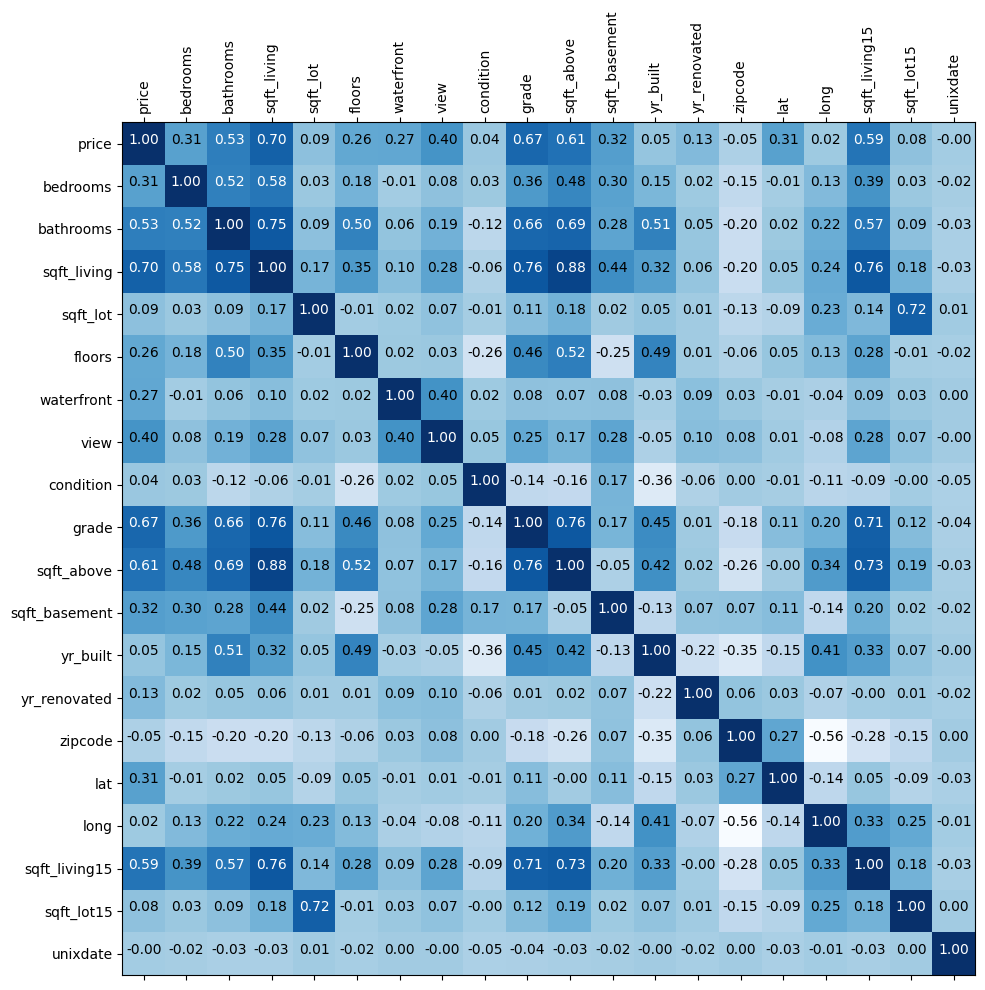

In [38]:
import itertools
import matplotlib.pyplot as plt

def plot_matrix(cm, labels, normalize=False, title='', cmap=plt.cm.Blues):
    fig = plt.figure(figsize=(10,10))
    ax=fig.add_subplot(111)
    ax.matshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    # plt.colorbar()
    tick_marks = np.arange(len(labels))
    plt.xticks(tick_marks, labels, rotation=90)
    ax.set_xticks(tick_marks)
    ax.set_yticks(tick_marks)
    ax.set_xticklabels(labels)
    # ax.set_yticklabels(['']+labels)
    ax.set_yticklabels(labels)
 
    fmt = '.2f' #if normalize else 'd'
    thresh = 0.5
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
 
    plt.tight_layout()
    plt.show()
 
plot_matrix(rs, labels=df.columns)

In [39]:
index_of_price = df.columns.index('price')
low_correlation_threshold = 0.2
high_correlation_threshold = 0.8

columns_to_drop = [
    df.columns[i] for i in range(len(rs))
    if i != index_of_price and (np.abs(rs[i][index_of_price]) < low_correlation_threshold or np.abs(rs[i][index_of_price]) > high_correlation_threshold)
]

In [40]:
df3 = df.drop(*columns_to_drop)

In [41]:
model = train_and_test(df3)

In [42]:
df3_columns = df3.columns[1:]
coefficients = model.stages[1].coefficients

for column, coefficient in zip(df3_columns, coefficients):
    print(f"{column}: {coefficient:.3f}")

bedrooms: -31596.239
bathrooms: -6340.942
sqft_living: 104.934
floors: -28238.449
waterfront: 577679.296
view: 69834.850
grade: 79362.250
sqft_above: 99.807
sqft_basement: 98.265
lat: 664153.261
sqft_living15: 9.287


#### 4.2 Transformacja logarytmiczna macierzy

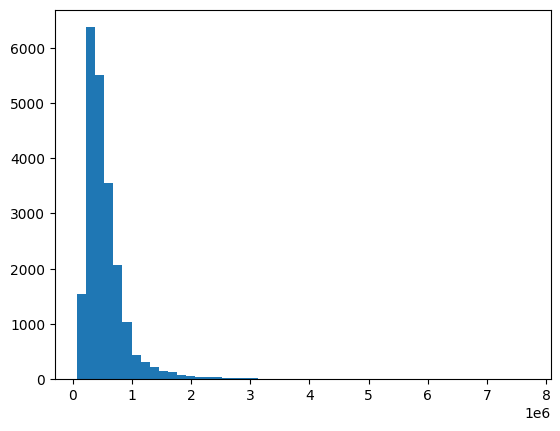

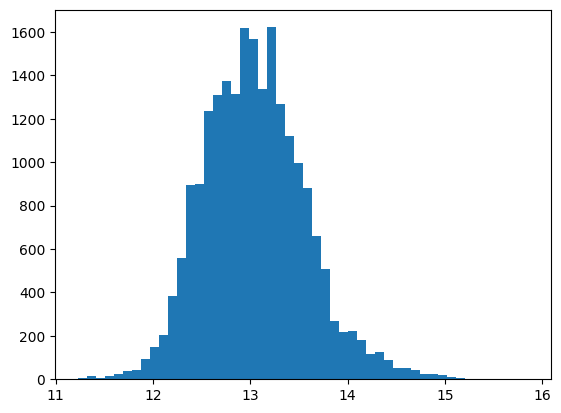

In [44]:
plt.hist(df.toPandas()['price'], bins=50)
plt.show()
 
plt.hist(np.log(df.toPandas()['price']), bins=50)
plt.show()

In [45]:
df3 = df.withColumn('logprice', log(col('price')))

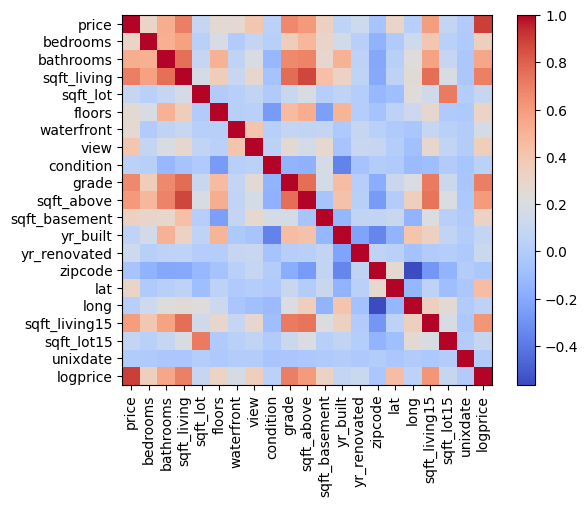

In [46]:
def display_correlation_matrix(df, columns):
    n = len(columns)
    corr_matrix = np.eye(n)
    for i in range(n):
        for j in range(i+1, n):
            corr_matrix[i][j] = corr_matrix[j][i] = df.stat.corr(columns[i], columns[j])

    plt.imshow(corr_matrix, interpolation='none', cmap='coolwarm')
    plt.colorbar()
    plt.xticks(range(n), columns, rotation='vertical')
    plt.yticks(range(n), columns)
    plt.show()

display_correlation_matrix(df3, df.columns + ['logprice'])

In [47]:
def train_and_test_log(df, feature_columns, label_column):
    train_data, test_data = df.randomSplit([0.8, 0.2], seed=42)
    va = VectorAssembler(inputCols=feature_columns, outputCol='features')
    lr = LinearRegression(featuresCol='features', labelCol=label_column)
    pipeline = Pipeline(stages=[va, lr])
    model = pipeline.fit(train_data)
    
    train_predictions = model.transform(train_data)
    test_predictions = model.transform(test_data)
    
    train_predictions = train_predictions.withColumn('exp_prediction', exp(col('prediction')))
    test_predictions = test_predictions.withColumn('exp_prediction', exp(col('prediction')))
    
    evaluator = RegressionEvaluator(labelCol=label_column, predictionCol='prediction', metricName='rmse')
    rmse = evaluator.evaluate(test_predictions)
    
    print(f"Root Mean Squared Error (RMSE) on test data: {rmse}")
    
    return train_predictions, test_predictions

In [48]:
feature_columns = df3.columns
feature_columns.remove('price')
feature_columns.remove('logprice')
label_column = 'logprice'

train_pred, test_pred = train_and_test_log(df3, feature_columns, label_column)

24/04/26 18:26:11 WARN Instrumentation: [23038bfa] regParam is zero, which might cause numerical instability and overfitting.
24/04/26 18:26:12 WARN InstanceBuilder: Failed to load implementation from:dev.ludovic.netlib.lapack.JNILAPACK
24/04/26 18:26:12 WARN Instrumentation: [23038bfa] Cholesky solver failed due to singular covariance matrix. Retrying with Quasi-Newton solver.
24/04/26 18:26:12 ERROR LBFGS: Failure! Resetting history: breeze.optimize.FirstOrderException: Line search zoom failed
24/04/26 18:26:12 ERROR LBFGS: Failure! Resetting history: breeze.optimize.FirstOrderException: Line search zoom failed
24/04/26 18:26:12 ERROR LBFGS: Failure again! Giving up and returning. Maybe the objective is just poorly behaved?


Root Mean Squared Error (RMSE) on test data: 0.24783473061715502


#### 4.2.2 Zastosowanie uogólnionego modelu liniowego 

In [49]:
from pyspark.ml.regression import GeneralizedLinearRegression
 
glr = GeneralizedLinearRegression(family="gaussian", link="log", maxIter=100, regParam=0.1, featuresCol="features", labelCol="price")

In [63]:
feature_columns = ['bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 
                   'waterfront', 'view', 'condition', 'grade', 'sqft_above', 
                   'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode', 
                   'lat', 'long', 'sqft_living15', 'sqft_lot15', 'unixdate']

va = VectorAssembler(inputCols=feature_columns, outputCol="features")
df_transformed = va.transform(df3)

In [64]:
model = glr.fit(df_transformed)
predictions = model.transform(df_transformed)

evaluator = RegressionEvaluator(labelCol="logprice", predictionCol="prediction", metricName="rmse")
rmse = evaluator.evaluate(predictions)
print("Root Mean Squared Error (RMSE):", rmse)

Root Mean Squared Error (RMSE): 621437.79679975


#### 4.3 Variance Inflaction Error

In [65]:
def compute_vif(df, label_col):
    feature_cols = df.columns
    feature_cols.remove(label_col)

    va = VectorAssembler(inputCols=feature_cols, outputCol="features_vif")
    df_vif = va.transform(df).select("features_vif", label_col)

    lr = LinearRegression(featuresCol="features_vif", labelCol=label_col)
    lr_model = lr.fit(df_vif)

    r2 = lr_model.summary.r2
    if r2 == 1:
        r2 -= 1e-10

    vif = 1 / (1 - r2)
    return vif

In [71]:
df3 = df.drop('price')
vifs = []
for f in df3.columns:
    vifs.append((f,compute_vif(df3, f)))

24/04/26 19:21:53 WARN Instrumentation: [75f4b50e] regParam is zero, which might cause numerical instability and overfitting.
24/04/26 19:21:54 WARN Instrumentation: [50913c50] regParam is zero, which might cause numerical instability and overfitting.
24/04/26 19:21:55 WARN Instrumentation: [243cbf43] regParam is zero, which might cause numerical instability and overfitting.
24/04/26 19:21:57 WARN Instrumentation: [536c9211] regParam is zero, which might cause numerical instability and overfitting.
24/04/26 19:21:58 WARN Instrumentation: [cdb79512] regParam is zero, which might cause numerical instability and overfitting.
24/04/26 19:22:00 WARN Instrumentation: [cbb2bb10] regParam is zero, which might cause numerical instability and overfitting.
24/04/26 19:22:01 WARN Instrumentation: [8267c6c0] regParam is zero, which might cause numerical instability and overfitting.
24/04/26 19:22:02 WARN Instrumentation: [5098997a] regParam is zero, which might cause numerical instability and overf

In [73]:
vif_df = spark.createDataFrame(vifs, ["feature", "VIF"])
vif_df_sorted = vif_df.orderBy(col("VIF").desc())
vif_df_sorted.show()

+-------------+------------------+
|      feature|               VIF|
+-------------+------------------+
|  sqft_living|9.99999917259636E9|
|   sqft_above|9.99999917259636E9|
|sqft_basement|9.99999917259636E9|
|        grade| 3.417999574675179|
|    bathrooms|3.3509682108463203|
|sqft_living15|2.9799167724127527|
|     yr_built| 2.430665145138505|
|   sqft_lot15| 2.135668231535926|
|     sqft_lot| 2.102605007050798|
|       floors|  2.01227862798032|
|         long|1.8257161252808956|
|      zipcode|1.6622215214033083|
|     bedrooms|1.6521273006561326|
|         view| 1.435410010684227|
|    condition|  1.25395614403158|
|   waterfront|1.2037731654235146|
|          lat|1.1813430557395295|
| yr_renovated| 1.151453867034837|
|     unixdate| 1.007368394833385|
+-------------+------------------+



In [77]:
variables_to_remove = ['sqft_living', 'sqft_above', 'sqft_basement']
df_filtered = df.drop(*variables_to_remove)
remaining_features = [c for c in df_filtered.columns if c != 'price']

va = VectorAssembler(inputCols=remaining_features, outputCol="features")
df_final = va.transform(df_filtered).select("features", "price")

lr = LinearRegression(featuresCol="features", labelCol="price")
lr_model = lr.fit(df_final)

predictions = lr_model.transform(df_final)
evaluator = RegressionEvaluator(predictionCol="prediction", labelCol="price", metricName="rmse")

rmse = evaluator.evaluate(predictions)
r2 = evaluator.evaluate(predictions, {evaluator.metricName: "r2"})
print(f"Root Mean Squared Error: {rmse}")
print(f"Coefficient of Determination R^2: {r2}")

24/04/26 19:27:21 WARN Instrumentation: [43bdecb4] regParam is zero, which might cause numerical instability and overfitting.


Root Mean Squared Error: 212752.31130774945
Coefficient of Determination R^2: 0.6641575784901709


In [85]:
remaining_features_including_sqft_living = remaining_features + ['sqft_living']

va = VectorAssembler(inputCols=remaining_features_including_sqft_living, outputCol="features")
df_final = va.transform(df_filtered).select("features", "price")

lr = LinearRegression(featuresCol="features", labelCol="price")
lr_model = lr.fit(df_final)

predictions = lr_model.transform(df_final)

rmse = evaluator.evaluate(predictions)
r2 = evaluator.evaluate(predictions, {evaluator.metricName: "r2"})
print(f"Root Mean Squared Error with 'sqft_living': {rmse}")
print(f"Coefficient of Determination R^2 with 'sqft_living': {r2}")

24/04/26 19:33:45 WARN Instrumentation: [c60abe51] regParam is zero, which might cause numerical instability and overfitting.
24/04/26 19:33:45 WARN Instrumentation: [c60abe51] Cholesky solver failed due to singular covariance matrix. Retrying with Quasi-Newton solver.
24/04/26 19:33:45 ERROR LBFGS: Failure! Resetting history: breeze.optimize.FirstOrderException: Line search zoom failed
24/04/26 19:33:45 ERROR LBFGS: Failure again! Giving up and returning. Maybe the objective is just poorly behaved?


Root Mean Squared Error with 'sqft_living': 200968.66716935384
Coefficient of Determination R^2 with 'sqft_living': 0.700329713279454


#### 4.4 Normalizacja cech

In [86]:
from pyspark.ml.feature import StandardScaler
 
def train_and_test_scaled(df, lr=LinearRegression()
                          .setMaxIter(100)
                          .setRegParam(3.0)
                          .setElasticNetParam(0.5)
                          .setFeaturesCol("features_scaled")
                          .setLabelCol("price"),apply_normalization = False):

    feature_cols = [c for c in df.columns if c != lr.getLabelCol()]
    va = VectorAssembler(inputCols=feature_cols, outputCol="features")
    scaler = StandardScaler(inputCol="features", outputCol="features_scaled", withStd=True, withMean=False)

    stages = [va, scaler, lr]
    pipeline = Pipeline(stages=stages)

    train_df, test_df = df.randomSplit([0.7, 0.3], seed=42)

    model = pipeline.fit(train_df)
    predictions = model.transform(test_df)

    evaluator = RegressionEvaluator(labelCol="price", predictionCol="prediction", metricName="rmse")
    rmse = evaluator.evaluate(predictions)
    print(f"Root Mean Squared Error (RMSE): {rmse}")
    
    return model

In [89]:
trained_model = train_and_test_scaled(df)

Root Mean Squared Error (RMSE): 193790.55522456192


In [107]:
coefficients = trained_model.stages[-1].coefficients
intercept = trained_model.stages[-1].intercept

print(f"Intercept: {intercept:.3f}")
print("Coefficients")
for i, coef in enumerate(coefficients):
    print(f"{coef:.3f} - {df.columns[i+1]}")

# Skalowanie ma wpływ w przypadku regularyzacji ponieważ w tych algorytmach jest wyznaczana kara za wielkość 
# współczynników. Różne zakresy mogłyby prowadzić do nieproporcjonalnych kar.

Intercept: 4649772.807
Coefficients
-39132.375 - bedrooms
29518.657 - bathrooms
90121.974 - sqft_living
3894.309 - sqft_lot
4039.201 - floors
47117.546 - waterfront
42102.511 - view
19638.561 - condition
109823.027 - grade
79654.463 - sqft_above
27627.979 - sqft_basement
-76313.792 - yr_built
8227.377 - yr_renovated
-31901.326 - zipcode
83869.055 - lat
-31652.744 - long
17199.151 - sqft_living15
-10361.398 - sqft_lot15
13507.167 - unixdate


### 5. Cechy wielomianowe:

#### 5.1 Czy lokalizacja domów ma wpływ na cenę?

In [112]:
import geopandas as gpd

pdf = df.toPandas()
gdf = gpd.GeoDataFrame(pdf, geometry=gpd.GeoSeries.from_xy(pdf['long'], pdf['lat']), crs=4326)
gdf.explore('price')

In [119]:
min_price, max_price = df.agg({'price':'min'}).collect()[0][0], df.agg({'price':'max'}).collect()[0][0]
print(f'Min house price: {min_price}. Max house price: {max_price}')

Min house price: 75000.0. Max house price: 7700000.0


In [120]:
gdf[gdf.price <= gdf.price.quantile(.95)].explore('price')

In [127]:
df = df.withColumn('lat_2', col('lat') * col('lat'))
df = df.withColumn('long_2', col('long') * col('long'))
df = df.withColumn('lat_long', col('lat') * col('long'))

In [128]:
feature_columns = ['lat_2', 'long_2', 'lat_long']
va = VectorAssembler(inputCols=feature_columns, outputCol="features")
df_features = va.transform(df)

lr = LinearRegression(featuresCol="features", labelCol="price")
lr_model = lr.fit(df_features)

predictions = lr_model.transform(df_features)

24/04/26 20:02:01 WARN Instrumentation: [17832288] regParam is zero, which might cause numerical instability and overfitting.


In [129]:
coefficients = lr_model.coefficients
intercept = lr_model.intercept

In [130]:
print(f"Intercept: {intercept:.3f}")
print("Coefficients")
for i, coef in enumerate(coefficients):
    print(f"{coef:.3f} - {feature_columns[i]}")

Intercept: -3612000.822
Coefficients
-2608347.338 - lat_2
-396865.115 - long_2
-2035587.252 - lat_long


In [131]:
evaluator = RegressionEvaluator(predictionCol="prediction", labelCol="price", metricName="rmse")
rmse = evaluator.evaluate(predictions)
r2 = evaluator.evaluate(predictions, {evaluator.metricName: "r2"})

print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"Coefficient of Determination R^2: {r2}")

Root Mean Squared Error (RMSE): 343461.9576343936
Coefficient of Determination R^2: 0.12472553083904292


#### 5.2 Cechy wielomianowe dla wszystkich atrybutów

In [139]:
trained_model = train_and_test_scaled_polynomial_features(df)

RMSE: 159238.826. R^2: 0.797


In [ ]:
#### 5.3 Inne algorytmy regresji

In [159]:
from pyspark.ml.feature import MinMaxScaler, PolynomialExpansion
 
def train_and_test_scaled_polynomial_features(df, reg_model):
    
    feature_columns = [c for c in df.columns if c != 'price']
    va = VectorAssembler(inputCols=feature_columns, outputCol="features")
    scaler = MinMaxScaler(inputCol="features", outputCol="scaled_features")
    polyExpansion = PolynomialExpansion(inputCol="scaled_features", outputCol="features_poly")
    pipeline = Pipeline(stages=[va, scaler, polyExpansion, reg_model])

    train_data, test_data = df.randomSplit([0.7, 0.3], seed=42)
    model = pipeline.fit(train_data)

    test_predictions = model.transform(test_data)
    evaluator = RegressionEvaluator(predictionCol="prediction", labelCol="price", metricName="rmse")
    
    rmse = evaluator.evaluate(test_predictions)
    r2 = evaluator.evaluate(test_predictions, {evaluator.metricName: "r2"})
    print(f"RMSE: {rmse:.3f}. R^2: {r2:.3f}")

    return model

In [160]:
lr = LinearRegression().setMaxIter(100).setRegParam(3.0).setElasticNetParam(0.5).setFeaturesCol("features_poly").setLabelCol("price")
model = train_and_test_scaled_polynomial_features(df, lr)

RMSE: 159238.826. R^2: 0.797


#### 5.3 Inne algorytmy regresji

In [161]:
from pyspark.ml.regression import DecisionTreeRegressor, RandomForestRegressor, GBTRegressor

for r in [DecisionTreeRegressor(labelCol="price"), RandomForestRegressor(labelCol="price"), GBTRegressor(labelCol="price")]:
    print(f'=== {r.__class__.__name__} ===')
    model = train_and_test_scaled_polynomial_features(df, r)

=== DecisionTreeRegressor ===


RMSE: 184876.113. R^2: 0.726
=== RandomForestRegressor ===


RMSE: 160839.992. R^2: 0.793
=== GBTRegressor ===


RMSE: 177368.012. R^2: 0.748
